# Introduction

L'objectif de ce projet est de mettre en place un modèle de machine learning qui effectue des recommandations de musiques. Le cas d'usage principal étant de trouver les musiques ayant le plus de similarités avec une musique donnée, en s'appuyant sur les caractéristiques suivantes:
- Genre 
- BPM (tempo)
- Énergie
- Clé
- Couleur (*valence*)
- Autres paramètres moins importants tels que la *danceability* ou l'accoustique

Il s'agit donc d'un système de recommandation *content-based*, qui se focalise sur le contenu de la musique plutôt que sur les utilisateurs.

In [1]:
import numpy as np
import pandas as pd
import os

import plotly.express as px
import nbformat

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from sklearn.metrics.pairwise import sigmoid_kernel
from sklearn.metrics.pairwise import cosine_similarity

import seaborn as sns 
import matplotlib.pyplot as plt
%matplotlib inline

df_data = pd.read_csv('./data/data.csv')
df_genre = pd.read_csv('./data/data_by_genres.csv')
df_year = pd.read_csv('./data/data_by_year.csv')
df_artist = pd.read_csv('./data/data_by_artist.csv')
df_wgenre = pd.read_csv('./data/data_w_genres.csv')


# Data Analysis

Pour cette première partie réservée à l'analyse de données, nous utiliserons une source de données tirée de Kaggle, celle-ci a l'avantage d'être relativement réduite en termes de taille, tout en portant tous les détails que nous pouvons obtenir via l'API de Spotify. (source: https://www.kaggle.com/datasets/vatsalmavani/spotify-dataset)

## Lecture et visualisation des données

In [2]:
df_data.head(5)

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.982,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.732,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.961,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.101,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.967,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.381,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.957,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.229,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665


In [3]:
df_genre.head(1)

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,21st century classical,0.979333,0.162883,160297.666667,0.071317,0.606834,0.3616,-31.514333,0.040567,75.3365,0.103783,27.833333,6


In [4]:
df_year.head(1)

,mode,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,1921,0.886896,0.418597,260537.166667,0.231815,0.344878,0.20571,-17.048667,0.073662,101.531493,0.379327,0.653333,2


In [5]:
df_artist.head(1)

,mode,count,acousticness,artists,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,9,0.590111,"""Cats"" 1981 Original London Cast",0.467222,250318.555556,0.394003,0.0114,0.290833,-14.448,0.210389,117.518111,0.3895,38.333333,5


In [6]:
df_wgenre.head(1)

,genres,artists,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode,count
0,['show tunes'],"""Cats"" 1981 Original London Cast",0.590111,0.467222,250318.555556,0.394003,0.0114,0.290833,-14.448,0.210389,117.518111,0.3895,38.333333,5,1,9


In [7]:
print(df_data.dtypes)

valence             float64
year                  int64
acousticness        float64
artists              object
danceability        float64
duration_ms           int64
energy              float64
explicit              int64
id                   object
instrumentalness    float64
key                   int64
liveness            float64
loudness            float64
mode                  int64
name                 object
popularity            int64
release_date         object
speechiness         float64
tempo               float64
dtype: object


## Nettoyage des colonnes

Aperçu et définition des attributs du jeu de données:

    Acousticness: measure from 0.0 to 1.0 of whether the track is acoustic.
    Danceability: describes how suitable a track is for dancing.
    duration_ms: the duration of the song track in milliseconds.
    Energy: a perceptual measure of intensity and activity.
    Instrumentalness: whether a track contains vocals or not.
    Loudness: loudness of a track in decibels(dB).
    Liveness: detects the presence of an audience in the recording.
    Speechiness: detects the presence of spoken words in a track
    Key: key the track is in. Integers map to pitches using standard Pitch Class notation.
    Valence: measures from 0.0 to 1.0 describing the musical positiveness conveyed by a track.
    Tempo: in beats per minute (BPM).
    Mode: indicates the modality(major or minor) of the song.
    Song_title: the name of the song.
    Artist: the singer of the song.

In [8]:
df_data.drop(columns=['release_date'])
df_data = df_data.drop_duplicates()

J'ai choisi dans un premier temps de garder un maximum d'attributs afin d'avoir le plus de détails possible. Toutes les colonnes du jeu de données (sauf la date de sortie, qui ne nous intéresse pas car nous avons l'année de sortie) sont porteuses de valeur dans le cadre de notre cas d'usage.

## Analyse du jeu de données

Pour commencer, analysons l'évolution de différents attributs permettant de définir une musique (acoustique, énergie, instrumentalité...) au cours des décennies.

In [30]:
params = ['acousticness', 'instrumentalness']
plot = px.line(df_year, x='year', y=params,title="Évolution de l'acoustique et l'instrumentalité")
plot.show()

In [31]:
params = ['danceability', 'energy']
plot = px.line(df_year, x='year', y=params,title="Evolution de l'énergie dans la musique")
plot.show()

In [32]:
plot = px.line(df_year, x='year', y='loudness',title="Évolution de l'intensité sonore dans la musique")
plot.show()

On voit que l'acoustique et l'instrumentalité ont drastiquement baissé au fil des années, contrairement à l'énergie et l'intensité sonore qui ont beaucoup augmenté ces dernières décennies.

In [28]:
top10_genres = df_genre.nlargest(10, 'popularity')
top10_genres.head(10)

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,cluster
237,1,basshall,0.213167,0.81800,169799.166667,0.630167,0.000020,0.081067,-6.627833,0.134833,115.092500,0.588667,80.666667,2,3
2533,1,south african house,0.043833,0.84700,311854.333333,0.562333,0.130339,0.075133,-7.719000,0.050733,123.676333,0.834333,80.000000,1,3
2755,1,trap venezolano,0.044600,0.87700,231848.000000,0.777000,0.000035,0.086300,-4.246000,0.117000,102.020000,0.706000,80.000000,1,3
2778,0,turkish edm,0.008290,0.69800,186700.000000,0.719000,0.000004,0.326000,-4.923000,0.045500,120.062000,0.364000,80.000000,0,4
46,0,alberta hip hop,0.330000,0.88500,144000.000000,0.685000,0.000000,0.148000,-6.429000,0.062700,99.954000,0.937000,78.500000,11,4
536,0,chinese electropop,0.002570,0.66000,217088.000000,0.787000,0.000000,0.323000,-4.592000,0.032000,142.018000,0.199000,78.500000,1,4
37,0,afroswing,0.318450,0.71175,179995.375000,0.580187,0.000258,0.189950,-7.016687,0.195563,83.250125,0.676625,77.312500,11,4
31,0,afro soul,0.006270,0.76600,202627.000000,0.873000,0.000000,0.076400,-6.381000,0.143000,126.988000,0.743000,77.000000,11,4
575,1,circuit,0.009030,0.74500,189818.000000,0.972000,0.465000,0.297000,-3.506000,0.077400,128.031000,0.556000,77.000000,7,3
1239,1,guaracha,0.009030,0.74500,189818.000000,0.972000,0.465000,0.297000,-3.506000,0.077400,128.031000,0.556000,77.000000,7,3


En effet, nous constatons que les genres les plus populaires aujourd'hui jouissent d'une haute danceability et énergie. Ces 10 genres sont tous des sous-genres appartenant à la musique électronique.

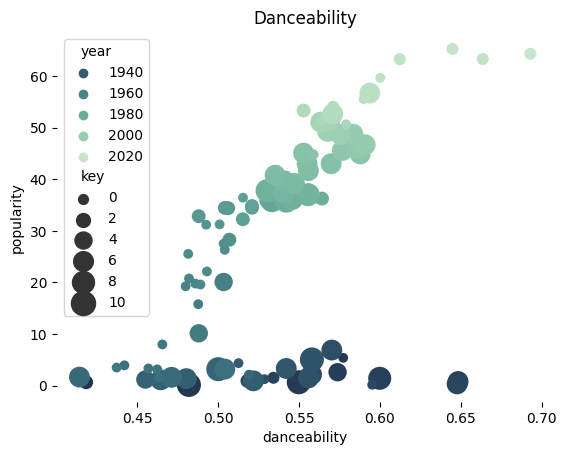

In [33]:
sns.scatterplot(x="danceability", y="popularity",
                hue="year", size="key",
                palette="ch:r=-.4,d=.2_r",
                sizes=(50, 300), linewidth=0,
                data=df_year,legend=True).set(title='Danceability')
sns.despine(left = True,bottom=True)

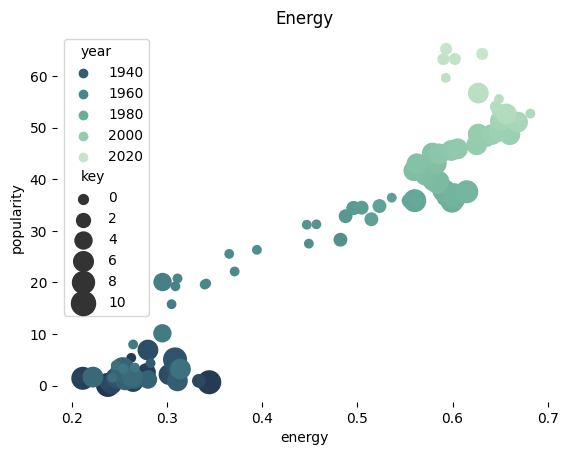

In [34]:
sns.scatterplot(x="energy", y="popularity",
                hue="year", size="key",
                palette="ch:r=-.4,d=.2_r",
                sizes=(50, 300), linewidth=0,
                data=df_year,legend=True).set(title='Energy')
sns.despine(left = True,bottom=True)

On voit ici que la danceability, l'énergie et les années sont fortement positivement corrélés avec la popularité. La popularité se basant sur les écoutes de Spotify, il est évident que les générations actuelles privilégient la musique de leur temps, surtout sur un support utilisé principalement par les moins de 35 ans. (https://www.statista.com/statistics/475821/spotify-users-age-usa/)

Ces résultats correspondent à la tendance que suit la musique depuis les années 60, grâce à la démocratisation des supports et des méthodes d'enregistrement. La musique est plus accessible à produire et à consommer. Aujourd'hui, avec l'explosion en popularité de la musique électronique, la facilité d'accès que propose les logiciels de MAO, ainsi qu'internet qui rend accessible à tous la consommation et le partage de musique, ces tendances paraissent tout à fait logiques.

# Clustering

## Genres

Nous utilisons ici l'algorithme K-means pour grouper les genres entre eux, en fonction de leurs similarités. L'algorithme t-SNE sera utilisé en premier lieu pour la réduction dimensionnelle. L'algorithme t-SNE permet de réduire à 2 le nombre de dimensions, et est utilisé avant tout pour la visualisation.

In [15]:
### k-mean algorithm
cluster_pipeline = Pipeline([('scaler',StandardScaler()),('kmeans', KMeans(n_clusters=5))])
genre_type = df_genre.select_dtypes(np.number)
cluster_pipeline.fit(genre_type)
df_genre['cluster'] = cluster_pipeline.predict(genre_type)

### tsne dimension reduction algorithm
tsne_pipeline = Pipeline([('scaler',StandardScaler()),('tsne', TSNE(n_components=2,verbose=1))])
genre_embedding = tsne_pipeline.fit_transform(genre_type)
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = df_genre['genres']
projection['cluster'] = df_genre['cluster']

### plotting
fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'],title='Clusters of genres')
fig.show()

c:\Users\MrFlo\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.029s...
[t-SNE] Computed neighbors for 2973 samples in 0.797s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.106232
[t-SNE] KL divergence after 1000 iterations: 1.392893


L'algorithme t-SNE permet de bien visualiser les différents clusters de genres, il est intéressant d'observer les similarités entre les genres. On constate que les genres similaires en termes de sonorité et d'époques sont groupés ensemble: transe/full on/psytrance par exemple sont groupés dans le même cluster, quand des genres plus vocaux et avec des sonorités plus légères comme une grande partie des styles de pop ou funk sont regroupés dans un autre.

## Musiques

Classons maintenant les morceaux entre eux, pour cela nous utilisons l'algorithme K-means pour le clustering puis PCA pour la réduction dimensionnelle.

In [16]:
### k-means algorithm clustering
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=25, 
                                   verbose=False))
                                 ], verbose=False)
song_type = df_data.select_dtypes(np.number)
song_cluster_pipeline.fit(song_type)
song_cluster_labels = song_cluster_pipeline.predict(song_type)
df_data['cluster_label'] = song_cluster_labels

### PCA dimension reduction algorithm
pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(song_type)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = df_data['name']
projection['cluster'] = df_data['cluster_label']

### plotting
plot = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'],title='Clusters of songs')
plot.show()

c:\Users\MrFlo\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Avec ce clustering, on peut encore une fois voir que les titres possédant des caractéristiques similaires (année, langue, genre) sont proches.

On peut en conclure qu'il doit être possible de générer des recommandations à partir d'un titre, en proposant par exemple les 10 points les plus proches.

# Systeme de recommandation

On peut proposer un système de recommandation basé sur la distance entre les points, en cherchant les points les plus proches de l'input, similairement à certains modèles de NLP.
Nous nous baserons sur 3 types de calcul de similarité et de réduction afin de les comparer:
- La distance cosine
- La distance euclidienne
- Sigmoid Kernel

## Distance cosine

In [17]:
# Reducting the dataset for memory issues
df_reduced = df_data[df_data['year'] > 2015]

# scaling and normalization, adjust cols depending on genre and what you're looking for
cols=['acousticness', 'danceability', 'duration_ms', 'energy',
      'instrumentalness', 'key', 'liveness', 'loudness', 'mode',
      'speechiness', 'tempo', 'valence', 'year']

scaler = song_cluster_pipeline.steps[0][1]
df_normalized =scaler.fit_transform(df_reduced[cols])

# Create cosine similarity matrix
cosine_matrix = cosine_similarity(df_normalized)

In [18]:
# Create a pandas series with song names
indices = pd.Series(df_reduced['name'],copy=False).reset_index(drop=True)



def generate_recommendations(song_title, similarity_matrix):
    """ 
    Inputs: song title and generated similarity matrix
    Output: Pandas series of recommended songs
    """
    # Get song indices in the pandas Series we created
    index=indices[indices == song_title].index[0]
    # Get list of songs for given songs
    score=list(enumerate(similarity_matrix[index]))
    # Sort the most similar songs
    similarity_score = sorted(score,key = lambda x:x[1],reverse = True)
    # Select the top-10 recommend songs
    similarity_score = similarity_score[1:11]
    top_songs_index = [i[0] for i in similarity_score]
    # Top 10 recommende songs
    top_10=df_reduced.iloc[top_songs_index]
    return top_10[['name','artists','year']].to_dict(orient='records')

print(generate_recommendations('Jocelyn Flores',cosine_matrix))

[{'name': 'GOSHA', 'artists': "['$NOT']", 'year': 2018}, {'name': 'Nikki Sixx', 'artists': "['Doobie']", 'year': 2017}, {'name': 'Water', 'artists': "['Ugly God']", 'year': 2016}, {'name': 'INFATUATION', 'artists': "['BROCKHAMPTON']", 'year': 2016}, {'name': 'Why Am I Waiting', 'artists': "['Papithbk']", 'year': 2018}, {'name': 'Water', 'artists': "['Ugly God']", 'year': 2017}, {'name': 'Kolors', 'artists': "['Monte Booker', 'Smino']", 'year': 2016}, {'name': 'Envy Me', 'artists': "['Calboy']", 'year': 2019}, {'name': 'Carry On', 'artists': "['XXXTENTACION']", 'year': 2017}, {'name': 'What They Want', 'artists': "['Russ']", 'year': 2017}]


In [19]:
# Cleaning memory, ignore this if you have no memory issues
del cosine_matrix

## Distance euclidienne

In [20]:
# Create euclidean similarity matrix
euclidean_matrix = euclidean_distances(df_normalized)

In [21]:
# Generating recommandations
print(generate_recommendations('Jocelyn Flores',euclidean_matrix))

[{'name': 'Cabin Sound', 'artists': "['HI-FI CAMP']", 'year': 2017}, {'name': 'Brain Relaxation', 'artists': "['Fabricants']", 'year': 2017}, {'name': '8-Bit CockPit', 'artists': "['520Hz']", 'year': 2017}, {'name': 'Empty Field Noise', 'artists': "['Mark Biem']", 'year': 2017}, {'name': 'Dulled White Noise', 'artists': "['Lila Om']", 'year': 2017}, {'name': 'Pneuma', 'artists': "['TOOL']", 'year': 2019}, {'name': 'Refiner', 'artists': "['Maverick City Music', 'Chandler Moore', 'Steffany Gretzinger']", 'year': 2019}, {'name': 'Big Fan Dulled', 'artists': "['The Noise Project']", 'year': 2017}, {'name': 'Clear Conscience', 'artists': "['Benjamin Martins']", 'year': 2019}, {'name': 'Box Fan Long Loop For Sleep', 'artists': "['Fan Sounds']", 'year': 2017}]


Là où la distance cosine donne des résultats très convaincants, la distance euclidienne propose souvent les mêmes recommandations de bruit blancs ou d'ambiance. Comme attendu, cette méthode de calcul ne semble donc pas adapté.

In [22]:
# Cleaning memory, ignore this if you have no memory issues
del euclidean_matrix

## Sigmoid Kernel

Sigmoid Kernel est un SVM utilisé principalement dans les réseaux de neuronne, je veux principalement voir si les résultats d'un algorithme de réduction plus avancé proposent des résultats différents de la distance cosine. J'ai remarqué que certains algorithmes de recommandation similaires s'en servaient alors je voulais comparer les résultats dans mon cas d'usage.

In [23]:
# Create euclidean similarity matrix
sigmoid_matrix = sigmoid_kernel(df_normalized)

In [24]:
# Generating recommandations
print(generate_recommendations('Jocelyn Flores',sigmoid_matrix))

[{'name': 'Betrayal - Skit', 'artists': "['Juice WRLD']", 'year': 2018}, {'name': 'Carry On', 'artists': "['XXXTENTACION']", 'year': 2017}, {'name': 'BOOTY CALL (skit)', 'artists': "['The Kid LAROI']", 'year': 2020}, {'name': 'GOSHA', 'artists': "['$NOT']", 'year': 2018}, {'name': 'Skit', 'artists': "['BTS']", 'year': 2020}, {'name': 'Water', 'artists': "['Ugly God']", 'year': 2017}, {'name': 'The Girl Next Door', 'artists': "['Tomppabeats']", 'year': 2016}, {'name': 'Water', 'artists': "['Ugly God']", 'year': 2016}, {'name': 'Guardian angel', 'artists': "['XXXTENTACION']", 'year': 2018}, {'name': 'Dead and Cold', 'artists': "['SadBoyProlific']", 'year': 2018}]


Les résultats semblent relativement pertinents mais moins précis que la distance euclidienne. Pour notre exemple l'algorithme semble avoir recommandé un certain nombre de musiques de type "skit" qui sont définitivement dans le même genre que la musique originale, mais sont plutôt à part en termes de sonorité.

In [25]:
# Cleaning memory, ignore this if you have no memory issues
del sigmoid_matrix

# Metriques et précisions

Il existe toutes sortes de métriques et de calculs de précision sur les résultats d'un système de recommandation. S'agissant d'un système content-based portant sur la musique, il est difficile d'évaluer la pertinence de celui-ci sans le comparer à un autre. Le problème étant, le jeu de données utilisé est **très** fortement réduit, car la source n'a sélectionné que les chansons les plus populaires de certains genres, le dataset ici est donc très loin d'être exhaustif et face à une problématique de mémoire, j'ai été contraint d'appliquer l'algorithme à un jeu de données encore plus réduit, ici les chansons sorties après 2015.

En moyenne, avec le jeu de données actuel, la distance cosine nous donne une précision d'environ 90%, les recommandations sont pertinentes la plupart du temps, restent dans le genre donné et sonnent similaires. La distance euclidienne frôle les 0% et sigmoid kernel propose des résultats intéressants, dépendant des genres, pour une moyenne d'environ 60%. 

Il est à noter que changer les paramètres (colonnes) utilisés en fonction du cas d'usage et du genre permet souvent d'affiner la précision et les résultats voulus. Par exemple en tant que DJ de musique électronique, je suis très intéressé par le BPM, l'énergie et la clé, enlever certains attributs inutiles du calcul permet donc d'obtenir des résultats plus précis.

# Conclusion

Nous avons pu développer un sytème de recommandation content-based totalement indépendant des préférences et habitudes des utilisateurs, ainsi que de la popularité. Cela a pour intérêt de pouvoir trouver des chansons peu connues et offre une alternative aux systèmes user-based qui sont aujourd'hui les plus populaires. J'aurais beaucoup aimé pouvoir travailler avec un jeu de données plus vaste afin de pouvoir générer plus de résultats et affiner la pertinence des réponses données par l'algorithme.